In [ ]:
# Step 1: Import libraries
!pip install ultralytics
import os
import requests
import pandas as pd
import numpy as np
import datetime
import time
import json
from concurrent import futures
from io import BytesIO
from PIL import Image
from matplotlib import pyplot as plt
%matplotlib inline 

## Retrieving Data
We will be collecting road traffic data thorughout 2023 to help train our model to predict road traffic (no_of_cars) at each traffic camera position given the <day_of_week, time_of_day, is_public_hol>

In [2]:
# helper function to retrieve json of traffic images at certain datetime
def retrieveCameraJSON(date_range_string):
    url="https://api.data.gov.sg/v1/transport/traffic-images"
    # Format the datetime in list to proper string format
    date_range_string=str(date_range_string)[:10]+"T"+str(date_range_string)[11:]
    params={
        "date_time" : str(date_range_string),
    }
    data=requests.get(url,params=params)

    data_json=data.json()

    return data_json

In [3]:
# retrieve json from start_datetime to end_datetime, X minutes apart
def retrieveJSONOverPeriod(start, end, freq, to_add_list):
    datetime_range =pd.date_range(start=start, end=end,freq=freq)
    
    # use concurrent processes to fetch from API
    num_fetched = 0
    with futures.ThreadPoolExecutor(max_workers=1000) as executor:
        future_to_url = {executor.submit(retrieveCameraJSON,dt) for dt in datetime_range}
        for future in futures.as_completed(future_to_url):
            to_add_list.append(future.result())
            num_fetched += 1
            if (num_fetched % 1000 == 0):
                print("fetched ", num_fetched)


In [4]:
# Make concurrent API calls for 2023 data (data every hour, ~6k rows)
# I chose to fetch from march onwards because I plan to use it to predict traffic
# only from April to July and I want to save time
list_jsons_2023=[]
retrieveJSONOverPeriod(start='1/1/2023', end='12/31/2023', freq="H", to_add_list=list_jsons_2023)

/common/home/users/j/jxteoh.2023/tmp/ipykernel_2414200/2294450105.py:3: FutureWarning: 'H' is deprecated and will be removed in a future version, please use 'h' instead.
  datetime_range =pd.date_range(start=start, end=end,freq=freq)


fetched  1000
fetched  2000
fetched  3000
fetched  4000
fetched  5000
fetched  6000
fetched  7000
fetched  8000


In [5]:
# Combine the list of JSON into a DataFrame
list_jsons_2023 = [i for i in list_jsons_2023 if ("items" in i and "cameras" in i['items'][0])]
data_2023 = pd.json_normalize(list_jsons_2023, record_path =['items','cameras'], errors='ignore')

In [6]:
data_2023.shape

(757645, 8)

In [7]:
data_2023.drop_duplicates(subset="image",inplace=True) # drop repeats if any
data_2023.sort_values(by=["timestamp", "camera_id"], inplace=True) # sort my datetime followed by camera_id
data_2023.reset_index(drop=True, inplace=True)
data_2023.head()

,timestamp,image,camera_id,location.latitude,location.longitude,image_metadata.height,image_metadata.width,image_metadata.md5
0,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1001,1.295313,103.871146,240,320,10699465263ec0d7a18636e880edd49e
1,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1002,1.319541,103.878563,240,320,54a45c88e921e1c83f25edd591292d50
2,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1003,1.323957,103.872858,240,320,81c75103b5c04ce124334e48e947ca20
3,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1004,1.319536,103.875067,240,320,6b445c38b680e8ad504d878918612bf6
4,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1005,1.363520,103.905394,240,320,3dc851ac7b8806ebabdba9f004630f90


In [9]:
data_2023.shape

(751800, 8)

In [10]:
# drop columns that we won't be using
data_2023.drop(['image_metadata.height', 'image_metadata.width', 'image_metadata.md5'], axis=1, inplace=True)
data_2023.head()

,timestamp,image,camera_id,location.latitude,location.longitude
0,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1001,1.295313,103.871146
1,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1002,1.319541,103.878563
2,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1003,1.323957,103.872858
3,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1004,1.319536,103.875067
4,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1005,1.363520,103.905394


### Adding Vehicle Count Labels using YOLOv5

In [ ]:
# no need to git clone yolov5
!pip install -r https://raw.githubusercontent.com/ultralytics/yolov5/master/requirements.txt

import torch
model = torch.hub.load('ultralytics/yolov5', 'yolov5s')
if torch.cuda.is_available():
    model.cuda()
device = torch.device("cuda")

In [18]:
response = requests.get(data_2023['image'][1441], stream=True)
img = Image.open(response.raw)

model.classes=[1,2,3,5,7] #[bicycle,cars,buses,motocycles,trucks]
results = model(img, size=640)

# Results
results.print()

image 1/1: 1080x1920 16 cars, 1 bus, 1 truck
Speed: 9.0ms pre-process, 5.9ms inference, 1.4ms NMS per image at shape (1, 3, 384, 640)


image 1/1: 1080x1920 16 cars, 1 bus, 1 truck
Speed: 3.9ms pre-process, 5.7ms inference, 1.2ms NMS per image at shape (1, 3, 384, 640)


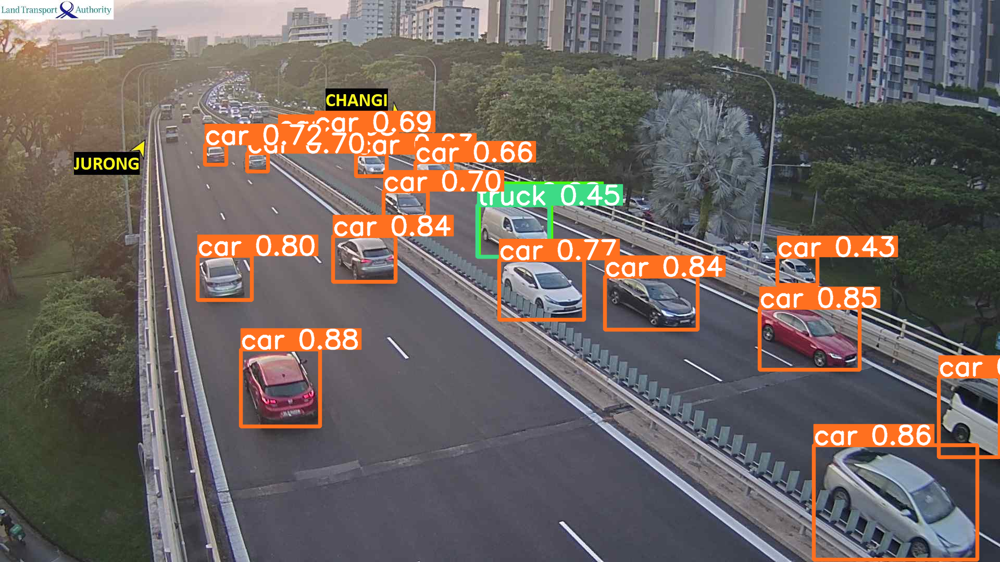

,xmin,ymin,xmax,ymax,confidence,class,name
0,462.986511,671.281738,614.275940,819.337891,0.884998,2,car
1,1562.614258,855.274414,1876.876221,1075.169556,0.856340,2,car
2,1458.725830,591.761841,1650.356689,710.776672,0.850254,2,car
3,1161.765625,531.207886,1339.430908,633.888000,0.844295,2,car
4,639.606323,453.446045,759.559814,541.515991,0.842694,2,car
5,379.318298,491.542145,483.326355,576.405640,0.795318,2,car
6,958.126099,499.927856,1121.076172,614.387390,0.765169,2,car
7,393.041748,278.309174,434.653656,316.221741,0.717728,2,car
8,1802.707275,723.705872,1919.439941,878.389709,0.712541,2,car
9,736.612488,367.135437,821.325195,429.408691,0.697962,2,car


In [19]:
results = model(img)
results.print()  
results.show()

results.xyxy[0]  # im1 predictions (tensor)
results.pandas().xyxy[0] # num_vehicles = len(results.pandas().xyxy[0])

We are gonna label each image with the number of vehicles in an unsupervised manner using YOLOv5, an object-detection AI

In [20]:
# for storing vehicle count
data_2023["vehicle_count"] = np.nan
data_2023.head()

,timestamp,image,camera_id,location.latitude,location.longitude,vehicle_count
0,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1001,1.295313,103.871146,NaN
1,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1002,1.319541,103.878563,NaN
2,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1003,1.323957,103.872858,NaN
3,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1004,1.319536,103.875067,NaN
4,2022-12-31T23:56:50+08:00,https://images.data.gov.sg/api/traffic-images/...,1005,1.363520,103.905394,NaN


In [21]:
from ultralytics import YOLO
# model = YOLO("yolov5s.pt")
model.classes=[1,2,3,5,7]


def getImages(data,index):
    row_num=index
    temp_url=data["image"][row_num]

    response = requests.get(temp_url, stream=True)
#     local_model = YOLO("yolov5s.pt")
    try : 
        img = Image.open(response.raw)
        results = model(img, size=640)
        
        # directly add vehicle count label so we avoid needing to save the images
        data.loc[row_num, "vehicle_count"] = len(results.pandas().xyxy[0])
        
    except:
        print("Error Occured", row_num)

In [ ]:
# Run concurrent getImages call for 2023 data
# we will get many errors but we will just filter out those rows later
from concurrent import futures
with futures.ThreadPoolExecutor(max_workers=40) as executor:
    future_to_url = {executor.submit(getImages,data=data_2023,index=data_2023.index[i]) for i in range(0, len(data_2023))}

print(len(data_2023[data_2023["vehicle_count"].isna()]))

Run one more time to fetch all the rows for which the API calls failed

In [ ]:
nan_indices = data_2023[data_2023['vehicle_count'].isnull()].index.tolist()

with futures.ThreadPoolExecutor(max_workers=40) as executor:
    future_to_url = {executor.submit(getImages,data=data_2023,index=data_2023.index[i]) for i in nan_indices}

print(len(data_2023[data_2023["vehicle_count"].isna()]))

In [25]:
data_2023.dropna(subset=['vehicle_count'], inplace=True)
camera_counts = data_2023['camera_id'].value_counts()
camera_counts

camera_id
4707    8434
2707    8433
4701    8431
4708    8427
5795    8426
        ... 
1003    8176
1505    8155
1113    6710
1112    6700
1111    6666
Name: count, Length: 90, dtype: int64

In [26]:
data_2023.to_csv("./data/processed_data_2023.csv")

Verify the labelled data

image 1/1: 1080x1920 3 cars, 2 buss
Speed: 10.1ms pre-process, 5.9ms inference, 1.2ms NMS per image at shape (1, 3, 384, 640)


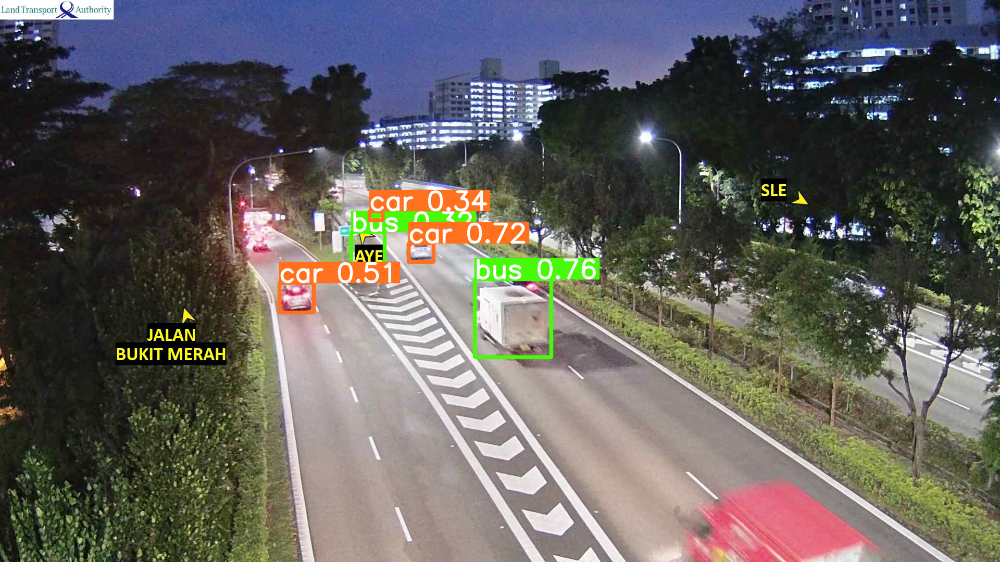

image 1/1: 1080x1920 5 cars
Speed: 9.5ms pre-process, 5.8ms inference, 1.2ms NMS per image at shape (1, 3, 384, 640)


Labelled:  5.0


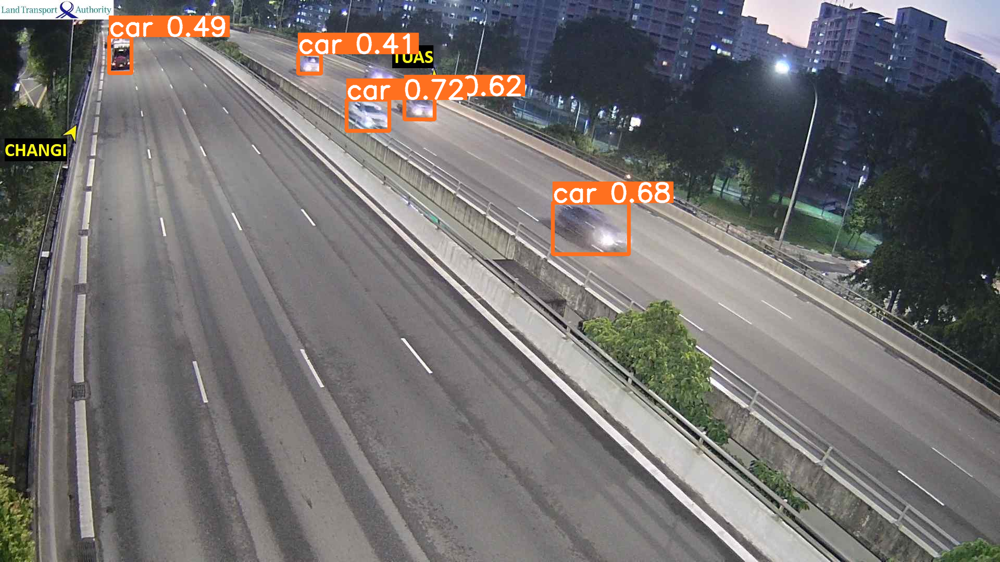

image 1/1: 1080x1920 (no detections)
Speed: 10.6ms pre-process, 6.6ms inference, 0.5ms NMS per image at shape (1, 3, 384, 640)


Labelled:  5.0


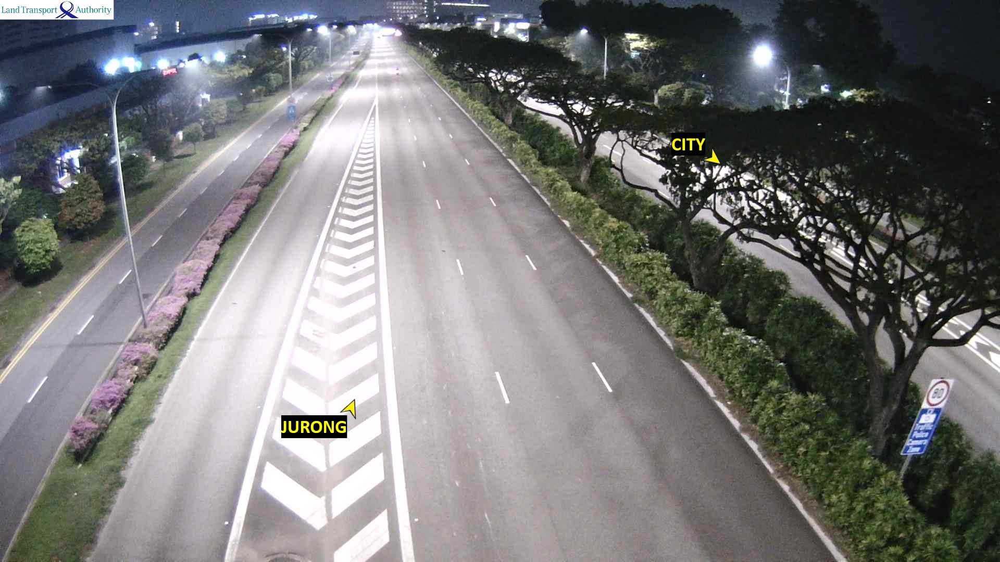

image 1/1: 240x320 1 car
Speed: 1.8ms pre-process, 67.7ms inference, 1.3ms NMS per image at shape (1, 3, 480, 640)


Labelled:  0.0


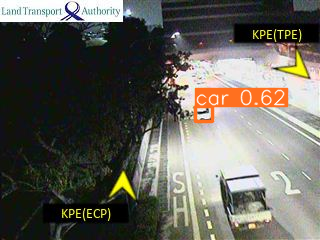

image 1/1: 1080x1920 6 cars, 1 bus, 2 trucks
Speed: 9.8ms pre-process, 6.2ms inference, 1.2ms NMS per image at shape (1, 3, 384, 640)


Labelled:  1.0


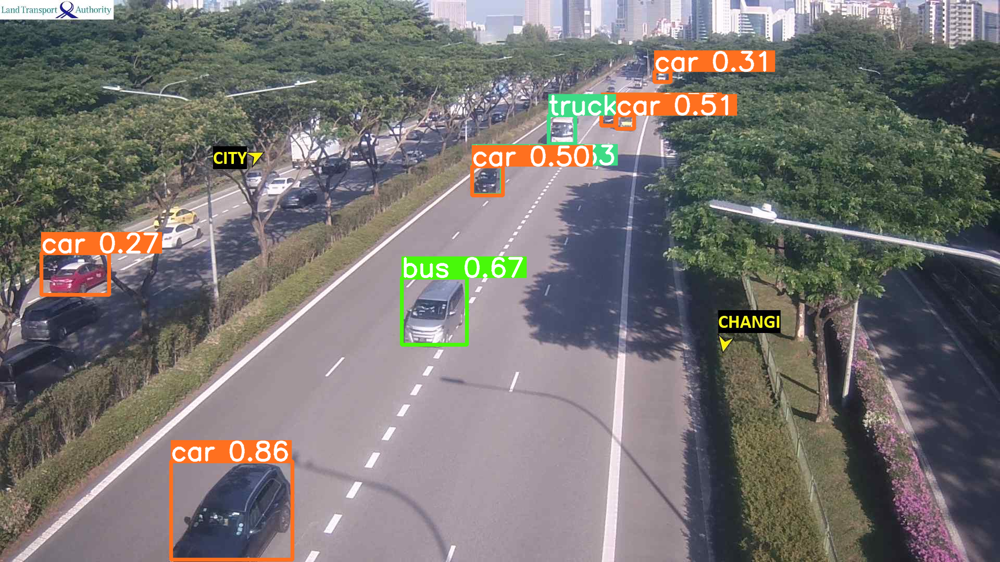

image 1/1: 1080x1920 12 cars
Speed: 8.5ms pre-process, 5.8ms inference, 1.2ms NMS per image at shape (1, 3, 384, 640)


Labelled:  9.0


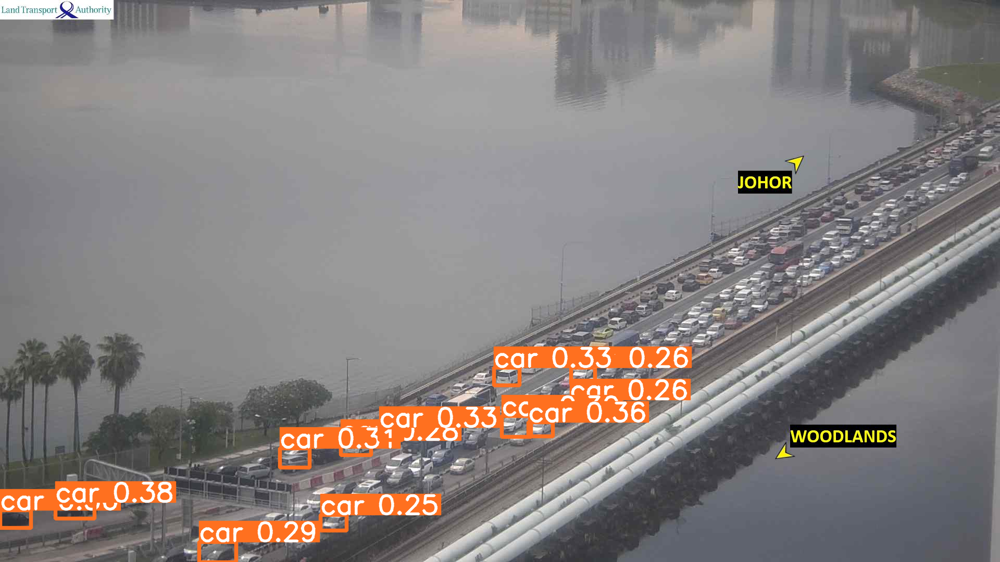

Labelled:  12.0


image 1/1: 1080x1920 3 cars
Speed: 8.2ms pre-process, 5.9ms inference, 1.2ms NMS per image at shape (1, 3, 384, 640)


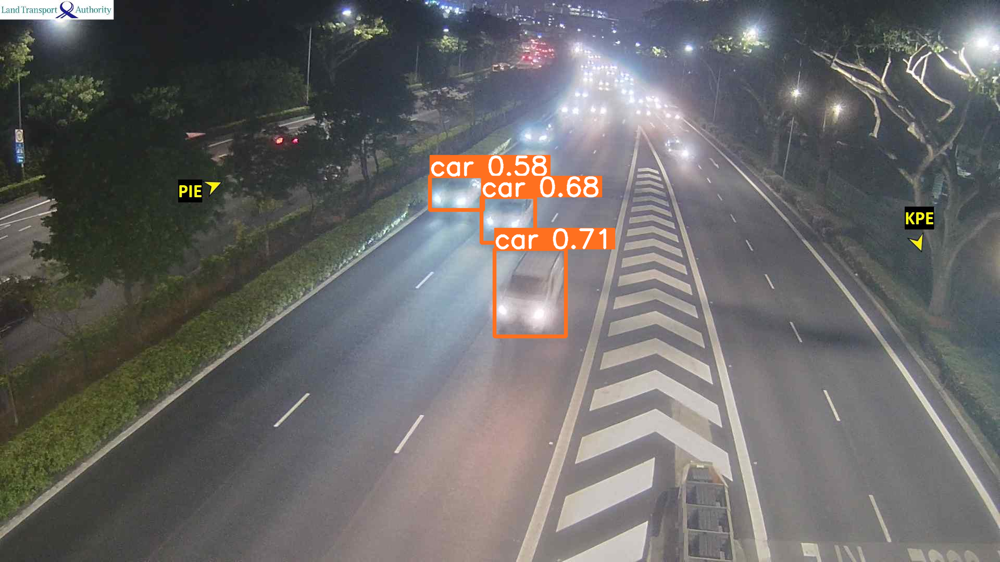

image 1/1: 1080x1920 7 cars, 1 bus
Speed: 8.9ms pre-process, 6.0ms inference, 1.4ms NMS per image at shape (1, 3, 384, 640)


Labelled:  3.0


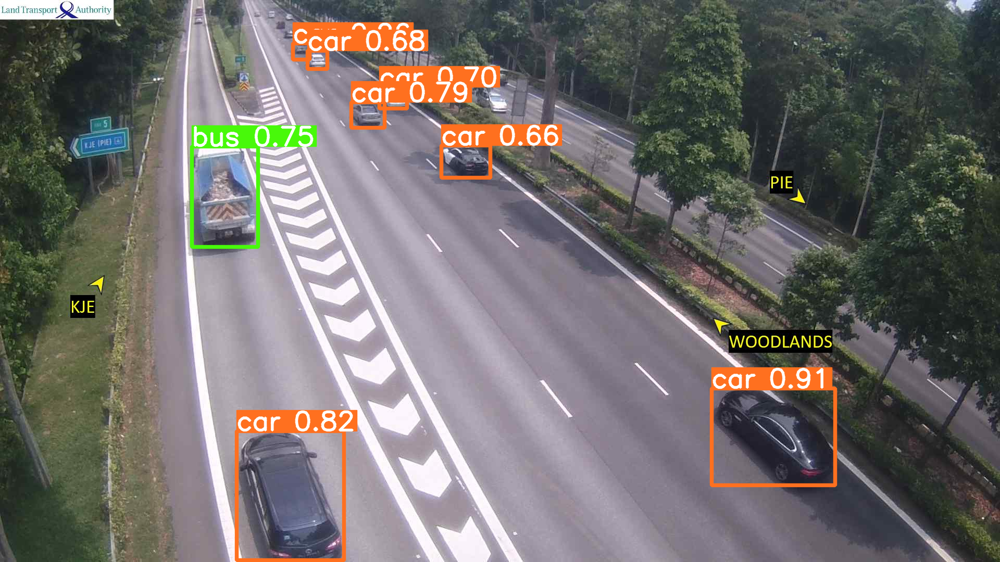

image 1/1: 240x320 (no detections)
Speed: 1.9ms pre-process, 6.1ms inference, 0.8ms NMS per image at shape (1, 3, 480, 640)


Labelled:  8.0


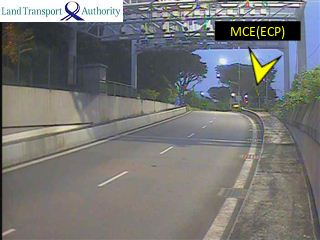

image 1/1: 1080x1920 3 cars
Speed: 8.5ms pre-process, 6.6ms inference, 1.3ms NMS per image at shape (1, 3, 384, 640)


Labelled:  0.0


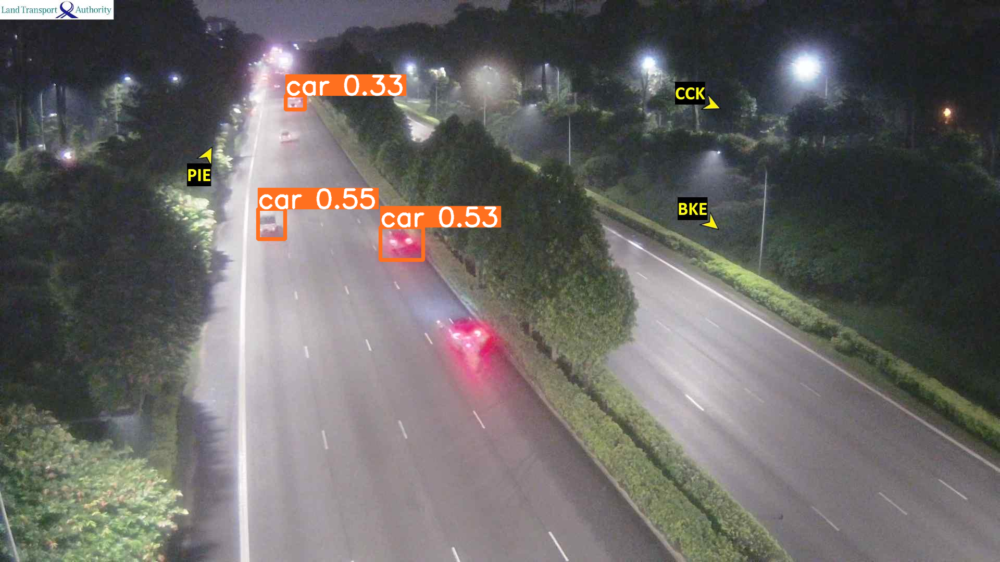

Labelled:  3.0


In [29]:
import random

for i in random.sample(range(746918), 10):
    response = requests.get(data_2023['image'][i], stream=True)
    img = Image.open(response.raw)

    results = model(img, size=640)
    results.print()  
    results.show()

    results.xyxy[0]
    print("Labelled: ", data_2023['vehicle_count'][i])

Seems like the data might not be the most accurate especially when it is zoomed out.